## Pseudoinverse-Guided Diffusion Models for Inverse Problems (Song et al., 2023)

### Imports

In [1]:
import torch
import torchvision
import torchvision.transforms.functional as F
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns

from PIL import Image
from tqdm import tqdm
import lpips
from guided_diffusion.unet import create_model

device = "cuda:0" if torch.cuda.is_available() else "cpu"
print("Device:", device)

!git clone https://github.com/DPS2022/diffusion-posterior-sampling.git
!cp -r diffusion-posterior-sampling/guided_diffusion guided_diffusion
!wget -nc -O ffhq256-1k-validation.zip 'https://www.dropbox.com/scl/fi/pppstbdsf0em6o0qscruc/ffhq256-1k-validation.zip?rlkey=xl7nwv2nxb6yvsirr3wad77hm'
!unzip -nq ffhq256-1k-validation.zip
!wget -nc -O ffhq_10m.pt 'https://www.dropbox.com/scl/fi/pq72vxzxcbygieq5z4gvf/ffhq_10m.pt?rlkey=5sxdj6r4o9f7b7bbp5fxg2f5r'

Device: cuda:0
fatal: destination path 'diffusion-posterior-sampling' already exists and is not an empty directory.
File ‘ffhq256-1k-validation.zip’ already there; not retrieving.
File ‘ffhq_10m.pt’ already there; not retrieving.


### Displaying and saving functions

In [2]:
def pilimg_to_tensor(pil_img):
  t = torchvision.transforms.ToTensor()(pil_img)
  t = 2*t-1 # [0,1]->[-1,1]
  t = t.unsqueeze(0)
  t = t.to(device)
  return(t)

def display_as_pilimg(t):
  t = 0.5+0.5*t.to('cpu')
  t = t.squeeze()
  t = t.clamp(0.,1.)
  pil_img = torchvision.transforms.ToPILImage()(t)
  display(pil_img)
  return(pil_img)

def display_and_save_as_pdf(t, filename):
    # Convert the tensor image to a PIL image
    t = 0.5 + 0.5 * t.to('cpu')
    t = t.squeeze()
    t = t.clamp(0., 1.)
    pil_img = torchvision.transforms.ToPILImage()(t)

    # Display the image using matplotlib
    plt.imshow(pil_img)
    plt.axis('off')  # Hide the axis

    # Save the figure as a PDF file
    plt.savefig(filename, bbox_inches='tight', pad_inches=0)
    plt.show()

def display_images_with_captions(images, captions, path, white=True):
    # Convert the tensor images to PIL images
    pil_images = []
    for img in images:
        img = 0.5 + 0.5 * img.to('cpu')
        img = img.squeeze()
        img = img.clamp(0., 1.)
        pil_img = torchvision.transforms.ToPILImage()(img)
        pil_images.append(pil_img)

    # Display the images with captions
    fig, axes = plt.subplots(1, len(pil_images), figsize=(30, 10))
    for ax, img, caption in zip(axes, pil_images, captions):
        ax.imshow(img)
        ax.set_title(caption, fontsize=25)
        ax.axis('off')

    # Adjust the layout to reduce space between images
    plt.subplots_adjust(wspace=0., hspace=0.)
    
    if white:
        plt.savefig(path, bbox_inches='tight')
    else:
        plt.savefig(path, bbox_inches='tight', pad_inches=0)
    plt.show()

### Metrics

In [3]:
def mypsnr(x,y):
  error = torch.mean((x-y)**2).item()
  psnr = 10*np.log10(2**2/error)
  return(psnr)

### U-Net Model

In [4]:
# Load model
model_config = {'image_size': 256,
                'num_channels': 128,
                'num_res_blocks': 1,
                'channel_mult': '',
                'learn_sigma': True,
                'class_cond': False,
                'use_checkpoint': False,
                'attention_resolutions': 16,
                'num_heads': 4,
                'num_head_channels': 64,
                'num_heads_upsample': -1,
                'use_scale_shift_norm': True,
                'dropout': 0.0,
                'resblock_updown': True,
                'use_fp16': False,
                'use_new_attention_order': False,
                'model_path': 'ffhq_10m.pt'}

model = create_model(**model_config)
model = model.to(device)
# use in eval mode:
model.eval();

/users/eleves-b/2021/jeremie.touati/MVAGenerativeModeling/Project/guided_diffusion/unet.py:88: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(th.load(mo

### Implementation of H used for deblurring (Kawar et al.)

In [5]:
class H_functions:
    """
    A class replacing the SVD of a matrix H, perhaps efficiently.
    All input vectors are of shape (Batch, ...).
    All output vectors are of shape (Batch, DataDimension).
    """

    def V(self, vec):
        """
        Multiplies the input vector by V
        """
        raise NotImplementedError()

    def Vt(self, vec):
        """
        Multiplies the input vector by V transposed
        """
        raise NotImplementedError()

    def U(self, vec):
        """
        Multiplies the input vector by U
        """
        raise NotImplementedError()

    def Ut(self, vec):
        """
        Multiplies the input vector by U transposed
        """
        raise NotImplementedError()

    def singulars(self):
        """
        Returns a vector containing the singular values. The shape of the vector should be the same as the smaller dimension (like U)
        """
        raise NotImplementedError()

    def add_zeros(self, vec):
        """
        Adds trailing zeros to turn a vector from the small dimension (U) to the big dimension (V)
        """
        raise NotImplementedError()
    
    def H(self, vec):
        """
        Multiplies the input vector by H
        """
        temp = self.Vt(vec)
        singulars = self.singulars()
        return self.U(singulars * temp[:, :singulars.shape[0]])
    
    def Ht(self, vec):
        """
        Multiplies the input vector by H transposed
        """
        temp = self.Ut(vec)
        singulars = self.singulars()
        return self.V(self.add_zeros(singulars * temp[:, :singulars.shape[0]]))
    
    def H_pinv(self, vec):
        """
        Multiplies the input vector by the pseudo inverse of H
        """
        temp = self.Ut(vec)
        singulars = self.singulars()
        temp[:, :singulars.shape[0]] = temp[:, :singulars.shape[0]] / singulars
        return self.V(self.add_zeros(temp))
    

class Deblurring(H_functions):
    def mat_by_img(self, M, v):
        return torch.matmul(M, v.reshape(v.shape[0] * self.channels, self.img_dim,
                        self.img_dim)).reshape(v.shape[0], self.channels, M.shape[0], self.img_dim)

    def img_by_mat(self, v, M):
        return torch.matmul(v.reshape(v.shape[0] * self.channels, self.img_dim,
                        self.img_dim), M).reshape(v.shape[0], self.channels, self.img_dim, M.shape[1])

    def __init__(self, kernel, channels, img_dim, device, ZERO = 3e-2):
        self.img_dim = img_dim
        self.channels = channels
        #build 1D conv matrix
        H_small = torch.zeros(img_dim, img_dim, device=device)
        for i in range(img_dim):
            for j in range(i - kernel.shape[0]//2, i + kernel.shape[0]//2):
                if j < 0 or j >= img_dim: continue
                H_small[i, j] = kernel[j - i + kernel.shape[0]//2]
        #get the svd of the 1D conv
        self.U_small, self.singulars_small, self.V_small = torch.svd(H_small, some=False)
        #ZERO = 3e-2
        self.singulars_small[self.singulars_small < ZERO] = 0
        #calculate the singular values of the big matrix
        self._singulars = torch.matmul(self.singulars_small.reshape(img_dim, 1), self.singulars_small.reshape(1, img_dim)).reshape(img_dim**2)
        #sort the big matrix singulars and save the permutation
        self._singulars, self._perm = self._singulars.sort(descending=True) #, stable=True)

    def V(self, vec):
        #invert the permutation
        temp = torch.zeros(vec.shape[0], self.img_dim**2, self.channels, device=vec.device)
        temp[:, self._perm, :] = vec.clone().reshape(vec.shape[0], self.img_dim**2, self.channels)
        temp = temp.permute(0, 2, 1)
        #multiply the image by V from the left and by V^T from the right
        out = self.mat_by_img(self.V_small, temp)
        out = self.img_by_mat(out, self.V_small.transpose(0, 1)).reshape(vec.shape[0], -1)
        return out

    def Vt(self, vec):
        #multiply the image by V^T from the left and by V from the right
        temp = self.mat_by_img(self.V_small.transpose(0, 1), vec.clone())
        temp = self.img_by_mat(temp, self.V_small).reshape(vec.shape[0], self.channels, -1)
        #permute the entries according to the singular values
        temp = temp[:, :, self._perm].permute(0, 2, 1)
        return temp.reshape(vec.shape[0], -1)

    def U(self, vec):
        #invert the permutation
        temp = torch.zeros(vec.shape[0], self.img_dim**2, self.channels, device=vec.device) #torch.Size([1, 65536, 3]) temp shape in U 1
        temp[:, self._perm, :] = vec.clone().reshape(vec.shape[0], self.img_dim**2, self.channels) #torch.Size([1, 65536, 3]) temp shape in U 2
        temp = temp.permute(0, 2, 1)
        #multiply the image by U from the left and by U^T from the right
        out = self.mat_by_img(self.U_small, temp)  #torch.Size([1, 3, 256, 256]) out shape in U 4
        out = self.img_by_mat(out, self.U_small.transpose(0, 1)).reshape(vec.shape[0], -1)   #torch.Size([1, 196608]) out shape in U 5
        return out

    def Ut(self, vec):
        #multiply the image by U^T from the left and by U from the right
        temp = self.mat_by_img(self.U_small.transpose(0, 1), vec.clone())
        temp = self.img_by_mat(temp, self.U_small).reshape(vec.shape[0], self.channels, -1)
        #permute the entries according to the singular values
        temp = temp[:, :, self._perm].permute(0, 2, 1)
        return temp.reshape(vec.shape[0], -1)

    def singulars(self):
        return self._singulars.repeat(1, 3).reshape(-1)

    def add_zeros(self, vec):
        return vec.clone().reshape(vec.shape[0], -1)

### DDPM class

In [6]:
class DDPM:
  def __init__(self, model=model):
    self.num_diffusion_timesteps = 1000
    self.reversed_time_steps = np.arange(self.num_diffusion_timesteps)[::-1]
    beta_start = 0.0001
    beta_end = 0.02
    self.betas = np.linspace(beta_start, beta_end, self.num_diffusion_timesteps,
                              dtype=np.float64)
    self.alphas = 1.0 - self.betas
    self.alphas_cumprod = np.cumprod(self.alphas, axis=0)
    self.alphas_cumprod_prev = np.append(1.0, self.alphas_cumprod[:-1])
    self.model = model
    self.imgshape = (1,3,256,256)


  def get_eps_from_model(self, x, t):
    # the model outputs:
    # - an estimation of the noise eps (chanels 0 to 2)
    # - learnt variances for the posterior  (chanels 3 to 5)
    
    model_output = self.model(x, torch.tensor(t, device=device).unsqueeze(0))
    model_output = model_output[:,:3,:,:]
    return(model_output)

  def predict_xstart_from_eps(self, x, eps, t):
    x_start = (
        np.sqrt(1.0 / self.alphas_cumprod[t])* x
        - np.sqrt(1.0 / self.alphas_cumprod[t] - 1) * eps
    )
    x_start = x_start.clamp(-1.,1.)
    return(x_start)

  def sample(self, show_steps=True):
    with torch.no_grad():  # avoid backprop wrt model parameters
      x = torch.randn(self.imgshape,device=device)  # initialize x_t for t=T
      for i, t in enumerate(self.reversed_time_steps):

          # TODO
          eps = self.get_eps_from_model(x, t)
          x = np.sqrt(1.0 / self.alphas[t])*(x - (1-self.alphas[t])*np.sqrt(1.0/(1-self.alphas_cumprod[t]))*eps) + np.sqrt(self.betas[t])*torch.randn_like(x)

          if i==0 or t%200==0 or t==0:
            print('Iteration:', i, '; Discrete time:', t)
            if show_steps:
              xhat = self.predict_xstart_from_eps(x, eps, t)
              display_as_pilimg(torch.cat((x, xhat), dim=3))

    return(x)

  def posterior_sampling(self, linear_operator, y, x_true=None, show_steps=True, vis_y=None):

    # visualization image for the observation y:
    if vis_y==None:
      vis_y = y

    # initialize xt for t=T
    x = torch.randn(self.imgshape,device=device)
    x.requires_grad = True
    for i, t in enumerate(self.reversed_time_steps):

      eps = self.get_eps_from_model(x, t)
      xhat = self.predict_xstart_from_eps(x, eps, t)
      mu = np.sqrt(1.0 / self.alphas[t])*(x - (1-self.alphas[t])*np.sqrt(1.0/(1-self.alphas_cumprod[t]))*eps)
      error = torch.linalg.norm(linear_operator(xhat)-y)**2
      zeta = 0.1 * torch.sqrt(1.0 / error)
      x = mu + np.sqrt(self.betas[t])*torch.randn_like(x) - zeta * torch.autograd.grad(error, x)[0]

      if i==0 or t%200==0 or t==0:
        if show_steps:
          print('Iteration:', i, '; Discrete time:', t)
          display_as_pilimg(torch.cat((x, xhat, x_true, vis_y), dim=3))

    return(x)

  def pseudoinverse_guidance_noiseless(self, H, H_pinv, y, coef, x_true=None, show_steps=True, vis_y=None):
    """ Pseudoinverse guidance reconstruction for non-linear inverse problems (without noise)."""
    
    # visualization image for the observation y:
    if vis_y==None:
      vis_y = y

    # initialize xt for t=T
    x = torch.randn(self.imgshape,device=device)
    x.requires_grad = True
    
    for i, t in enumerate(self.reversed_time_steps):
    
      eps = self.get_eps_from_model(x, t)
      xhat = self.predict_xstart_from_eps(x, eps, t)
      mu = np.sqrt(1.0 / self.alphas[t])*(x - (1-self.alphas[t])*np.sqrt(1.0/(1-self.alphas_cumprod[t]))*eps)
      
      mat = H_pinv(y) - H_pinv(H(xhat))
      mat_x = (mat.detach() * xhat).sum()
      guidance = torch.autograd.grad(mat_x, x)[0]
      zeta = coef * torch.sqrt(1.0 / torch.linalg.norm(mat_x))
      x = mu + np.sqrt(self.betas[t])*torch.randn_like(x) + zeta * guidance

      if i==0 or t%200==0 or t==0:
        
        if show_steps:
          print('Iteration:', i, '; Discrete time:', t)
          display_as_pilimg(torch.cat((x, xhat, x_true, vis_y), dim=3))
    
    return x
  
  def pseudoinverse_guidance_noisy(self, H, y, sigma_noise, coef, x_true=None, show_steps=True, vis_y=None):
    """ Pseudoinverse guidance reconstruction for linear inverse problems. """  
      
    # visualization image for the observation y:
    if vis_y==None:
      vis_y = y

    # initialize xt for t=T
    x = torch.randn(self.imgshape,device=device)
    x.requires_grad = True
    for i, t in enumerate(self.reversed_time_steps):

      eps = self.get_eps_from_model(x, t)
      xhat = self.predict_xstart_from_eps(x, eps, t)
      mu = np.sqrt(1.0 / self.alphas[t])*(x - (1-self.alphas[t])*np.sqrt(1.0/(1-self.alphas_cumprod[t]))*eps)
      
      g1 = y - torch.matmul(H, xhat)
      r2_t = 1 - self.alphas_cumprod[t]
      I = torch.zeros(H.shape, device=device)
      for c in range(H.shape[1]):
        I[0,c,:,:] = torch.eye(H.shape[2], device=device)
      
      g2 = (torch.matmul(H, H.transpose(2,3)) + (sigma_noise**2/r2_t)*I).inverse()
      g = torch.matmul(torch.matmul(g1.transpose(2,3), g2), H).transpose(2,3)
      mat = (g.detach() * xhat).sum()
      guidance = torch.autograd.grad(mat, x)[0]
      
      zeta = coef * torch.sqrt(1.0 / torch.linalg.norm(mat))

      x = mu + np.sqrt(self.betas[t])*torch.randn_like(x) + zeta * guidance

      if i==0 or t%200==0 or t==0:
        if show_steps:
          print('Iteration:', i, '; Discrete time:', t)
          display_as_pilimg(torch.cat((x, xhat, x_true, vis_y), dim=3))
    
    return x

  def pseudoinverse_guidance_inpainting(self, mask, y, sigma_noise, coef, x_true=None, show_steps=True, vis_y=None):
    """ Pseudoinverse guidance reconstruction for inpainting + denoising """  
      
    # visualization image for the observation y:
    if vis_y==None:
      vis_y = y

    # initialize xt for t=T
    x = torch.randn(self.imgshape,device=device)
    x.requires_grad = True
    for i, t in enumerate(self.reversed_time_steps):

      eps = self.get_eps_from_model(x, t)
      xhat = self.predict_xstart_from_eps(x, eps, t)
      mu = np.sqrt(1.0 / self.alphas[t])*(x - (1-self.alphas[t])*np.sqrt(1.0/(1-self.alphas_cumprod[t]))*eps)
      r2_t = 1 - self.alphas_cumprod[t]
      
      g = y - mask*xhat
      g = g*mask*(1/(1+sigma_noise**2/r2_t))
      
      mat = (g.detach() * xhat).sum()
      guidance = torch.autograd.grad(mat, x)[0]
      zeta = coef * torch.sqrt(1.0 / torch.linalg.norm(mat))

      x = mu + np.sqrt(self.betas[t])*torch.randn_like(x) + zeta * guidance

      if i==0 or t%200==0 or t==0:
        if show_steps:
          print('Iteration:', i, '; Discrete time:', t)
          display_as_pilimg(torch.cat((x, xhat, x_true, vis_y), dim=3))
    
    return x

  def pseudoinverse_guidance_deblurring(self, H, H_copy, sigma_noise, y, zeta_coeff, x_true=None, show_steps=True, vis_y=None):
    """ Pseudoinverse guidance reconstruction for deblurring + denoising"""  
      
    device = y.device  # Use the device of y as the reference device

    # visualization image for the observation y:
    if vis_y is None:
        vis_y = y

    # initialize xt for t=T
    x = torch.randn(self.imgshape, device=device)
    x.requires_grad = True

    for i, t in enumerate(self.reversed_time_steps):
        
        eps = self.get_eps_from_model(x, t)
        xhat = self.predict_xstart_from_eps(x, eps, t)
        
        mu = np.sqrt(1.0 / self.alphas[t]) * (x - (1 - self.alphas[t]) * np.sqrt(1.0 / (1 - self.alphas_cumprod[t])) * eps)
        
        r_t_2 = (1 - self.alphas_cumprod[t]) 
        
        H_tilde = H_copy
        singulars_inv = H_tilde._singulars
        singulars_inv = 1 / (singulars_inv + (sigma_noise**2/r_t_2))
        H_tilde._singulars = singulars_inv
    
        mat = H.Ht(H_tilde.H( y - H.H(xhat).reshape(1,3,256,256)).reshape(1,3,256,256)).reshape(1,3,256,256)
        mat_x = (mat.detach() * xhat).sum()
        guidance = torch.autograd.grad(mat_x, x)[0]

        zeta = zeta_coeff * torch.sqrt(1.0 / torch.linalg.norm(mat))
        x = mu + np.sqrt(self.betas[t]) * torch.randn_like(x) + zeta * guidance
        if i==0 or t%100==0 or t==0:
            if show_steps:
                display_as_pilimg(torch.cat((x, xhat, x_true, vis_y), dim=3))
                print('Iteration:', i, '; Discrete time:', t)
          
    return x

ddpm = DDPM()

### Choice of guidance scaling factor

In [6]:
sigma_noise = 0.1
idx = 100
x_true_pil = Image.open('ffhq256-1k-validation/'+str(idx).zfill(5)+'.png')
x_true = pilimg_to_tensor(x_true_pil)
mask = torch.ones_like(x_true)
y = mask*x_true.clone() + mask*(sigma_noise * torch.randn_like(x_true))

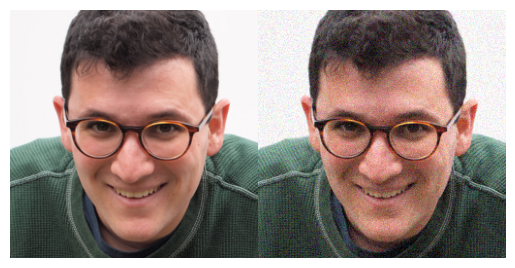

In [7]:
display_and_save_as_pdf(torch.cat((x_true, y), dim=3), 'rt2_ho_song/ho_song.pdf')

In [ ]:
coefs = [0.001, 0.005, 0.01, 0.05, 0.1, 0.2, 0.3, 0.5]
for coef in coefs:
  x_pseudoinverse = ddpm.pseudoinverse_guidance_inpainting(mask, y, sigma_noise, coef, x_true=x_true, show_steps=False)
  display_as_pilimg(torch.cat((x_true, y, x_pseudoinverse), dim=3))
  coef_name = str(coef).replace(".", "")
  torch.save(x_pseudoinverse, f"rt2_ho_song/coef{coef_name}_idx{idx}_ho.pt")

In [ ]:
for coef in coefs:
  x_pseudoinverse = ddpm.pseudoinverse_guidance_inpainting(mask, y, sigma_noise, coef, x_true=x_true, show_steps=False)
  display_as_pilimg(torch.cat((x_true, y, x_pseudoinverse), dim=3))
  coef_name = str(coef).replace(".", "")
  torch.save(x_pseudoinverse, f"rt2_ho_song/coef{coef_name}_idx{idx}_song.pt")

In [80]:
coefs = [0.001, 0.005, 0.01, 0.05, 0.1, 0.2, 0.3, 0.5]
idx = 100
ho_images = []
song_images = []
for coef in coefs:
    coef_name = str(coef).replace(".", "")
    ho_images.append(torch.load(f"rt2_ho_song/coef{coef_name}_idx{idx}_ho.pt").detach().cpu())
    song_images.append(torch.load(f"rt2_ho_song/coef{coef_name}_idx{idx}_song.pt").detach().cpu())

/tmp/ipykernel_1979384/1987381954.py:7: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  ho_images.append(torch.load(f"rt2_ho_song/coef{coef_name}_idx{idx}_ho.pt").detach().cpu

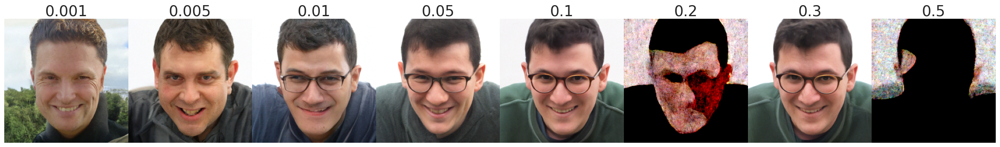

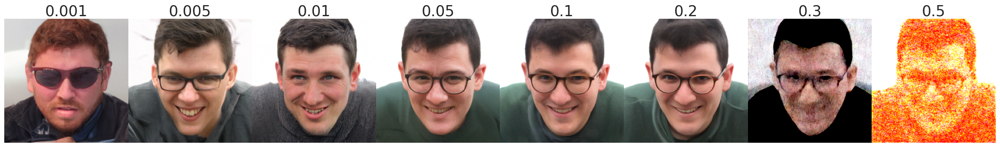

In [ ]:
display_images_with_captions(ho_images, coefs, "rt2_ho_song/ho.pdf")
display_images_with_captions(song_images, coefs, "rt2_ho_song/song.pdf")

### Denoising

In [24]:
H_inpainting = torch.zeros(ddpm.imgshape, device=device)
for i in range(256):
    H_inpainting[:,:,i,i] = 1
    
def linear_operator(x):
  return x

sigma_noise = 0.2
idx = 100
x_true_pil = Image.open('ffhq256-1k-validation/'+str(idx).zfill(5)+'.png')
x_true = pilimg_to_tensor(x_true_pil)
y = torch.matmul(H_inpainting, x_true.clone()) + torch.matmul(H_inpainting, sigma_noise * torch.randn_like(x_true))

In [ ]:
sigma_noises = [0.01, 0.05, 0.1, 0.15, 0.2, 0.3, 0.5]
indxs = [0, 2, 3, 4, 5]
for idx in indxs:
    for sigma_noise in sigma_noises:
        x_true_pil = Image.open('ffhq256-1k-validation/'+str(idx).zfill(5)+'.png')
        x_true = pilimg_to_tensor(x_true_pil)
        y = torch.matmul(H_inpainting, x_true.clone()) + torch.matmul(H_inpainting, sigma_noise * torch.randn_like(x_true))
        y = y.clamp(-1.,1.)
        
        x_chung = ddpm.posterior_sampling(linear_operator, y, x_true=x_true, show_steps=False)
        x_pseudoinverse = ddpm.pseudoinverse_guidance_noisy(H_inpainting, y, sigma_noise, 0.1, x_true=x_true, show_steps=False)
        print(f"--------------------sigma_noise: {sigma_noise}, idx: {idx}--------------------")
        display_as_pilimg(torch.cat((x_true, y, x_chung, x_pseudoinverse), dim=3))
        
        # Save both tensors in "denoising/" folder as .pt files
        sigma_name = str(sigma_noise).replace('.','')
        torch.save(x_chung, f"denoising/sigma{sigma_name}_idx{idx}_chung.pt")
        torch.save(x_pseudoinverse, f"denoising/sigma{sigma_name}_idx{idx}_pseudoinverse.pt")
        
        print(f"PNSR Noisy: {mypsnr(x_true, y):.4f}")
        print(f"PSNR Chung: {mypsnr(x_true, x_chung):.4f}")
        print(f"PSNR Pseudoinverse: {mypsnr(x_true, x_pseudoinverse):.4f}")

/tmp/ipykernel_210079/3481146194.py:10: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  x_chung = torch.load(f"denoising/sigma{str(sigma_noise).replace('.','')}_idx{idx}_chung

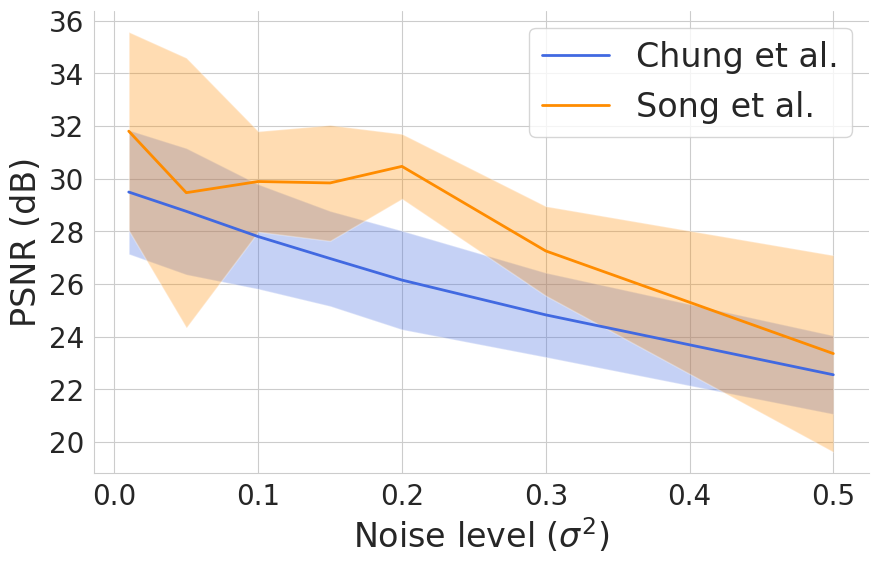

In [11]:
psnr_chung = []
psnr_pseudoinverse = []
indxs = [0,2,3,4,5]
sigma_noises = [0.01, 0.05, 0.1, 0.15, 0.2, 0.3, 0.5]

for sigma_noise in sigma_noises:
    psnr_chung_sigma = []
    psnr_pseudoinverse_sigma = []
    for idx in indxs:
        x_chung = torch.load(f"denoising/sigma{str(sigma_noise).replace('.','')}_idx{idx}_chung.pt")
        x_pseudoinverse = torch.load(f"denoising/sigma{str(sigma_noise).replace('.','')}_idx{idx}_pseudoinverse.pt")
        x_true_pil = Image.open('ffhq256-1k-validation/'+str(idx).zfill(5)+'.png')
        x_true = pilimg_to_tensor(x_true_pil)
        #display_as_pilimg(torch.cat((x_true, x_chung, x_pseudoinverse), dim=3))
        psnr_chung_sigma.append(mypsnr(x_true, x_chung))
        psnr_pseudoinverse_sigma.append(mypsnr(x_true, x_pseudoinverse))
    psnr_chung.append(psnr_chung_sigma)
    psnr_pseudoinverse.append(psnr_pseudoinverse_sigma)

# Compute mean and std deviation
chung_mean = np.array([np.mean(p) for p in psnr_chung])
chung_std = np.array([np.std(p) for p in psnr_chung])
pseudoinverse_mean = np.array([np.mean(p) for p in psnr_pseudoinverse])
pseudoinverse_std = np.array([np.std(p) for p in psnr_pseudoinverse])

# Style setup
sns.set_style("whitegrid")
plt.figure(figsize=(10, 6))

# Plot with correctly sized confidence bands
plt.plot(sigma_noises, chung_mean, label="Chung et al.", color="royalblue", linewidth=2)
plt.fill_between(sigma_noises, chung_mean - chung_std, chung_mean + chung_std, 
                 color="royalblue", alpha=0.3, edgecolor=None)

plt.plot(sigma_noises, pseudoinverse_mean, label="Song et al.", color="darkorange", linewidth=2)
plt.fill_between(sigma_noises, pseudoinverse_mean - pseudoinverse_std, pseudoinverse_mean + pseudoinverse_std, 
                 color="darkorange", alpha=0.3, edgecolor=None)

# Labels and legend with correct sigma squared notation
plt.xlabel("Noise level ($\sigma^2$)", fontsize=24)
plt.ylabel("PSNR (dB)", fontsize=24)
plt.legend(fontsize=24, loc="best")
# Change size of ticks
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)

# Improve aesthetics
sns.despine()
plt.savefig("denoising/results.pdf", bbox_inches="tight")
plt.show()

### Inpainting

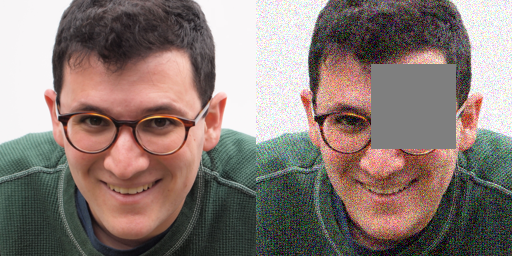

In [18]:
h = 256
w = 256
hcrop, wcrop = h//3, w//3
corner_top, corner_left = h//4, int(0.45*w)
mask = torch.ones(ddpm.imgshape, device=device)
mask[:,:,corner_top:corner_top+hcrop,corner_left:corner_left+wcrop] = 0

def linear_operator(x):
  return x*mask

sigma_noise = 0.2

idx = 100
x_true_pil = Image.open('ffhq256-1k-validation/'+str(idx).zfill(5)+'.png')
x_true = pilimg_to_tensor(x_true_pil)
y = linear_operator(x_true.clone()) + linear_operator(sigma_noise * torch.randn_like(x_true))

display_as_pilimg(torch.cat((x_true, y), dim=3));

In [ ]:
sigma_noises = [0.01, 0.05, 0.1, 0.15, 0.2, 0.3, 0.5]
indxs = [0,2,3,4,5]

for idx in indxs:
    for sigma_noise in sigma_noises:
        x_true_pil = Image.open('ffhq256-1k-validation/'+str(idx).zfill(5)+'.png')
        x_true = pilimg_to_tensor(x_true_pil)
        y = linear_operator(x_true.clone()) + linear_operator(sigma_noise * torch.randn_like(x_true))
        y = y.clamp(-1.,1.)
        
        x_chung = ddpm.posterior_sampling(linear_operator, y, x_true=x_true, show_steps=False)
        x_pseudoinverse = ddpm.pseudoinverse_guidance_inpainting(mask, y, sigma_noise, 0.1, x_true=x_true, show_steps=False)
        print(f"--------------------sigma_noise: {sigma_noise}, idx: {idx}--------------------")
        display_as_pilimg(torch.cat((x_true, y, x_chung, x_pseudoinverse), dim=3))
        
        # Save both tensors in "denoising/" folder as .pt files
        sigma_name = str(sigma_noise).replace('.','')
        torch.save(x_chung, f"inpainting_denoising/sigma{sigma_name}_idx{idx}_chung.pt")
        torch.save(x_pseudoinverse, f"inpainting_denoising/sigma{sigma_name}_idx{idx}_pseudoinverse.pt")
        
        # LPIPS score
        loss_fn_vgg = lpips.LPIPS(net='vgg').to(device)
        loss_fn_vgg.eval()
        lpips_chung = loss_fn_vgg(x_true, x_chung).item()
        lpips_pseudoinverse = loss_fn_vgg(x_true, x_pseudoinverse).item()
        print(f"LPIPS Chung: {lpips_chung:.4f}")
        print(f"LPIPS Pseudoinverse: {lpips_pseudoinverse:.4f}")

In [ ]:
for idx, sigma_noise in [(5,0.05)]:
    x_true_pil = Image.open('ffhq256-1k-validation/'+str(idx).zfill(5)+'.png')
    x_true = pilimg_to_tensor(x_true_pil)
    y = linear_operator(x_true.clone()) + linear_operator(sigma_noise * torch.randn_like(x_true))
    y = y.clamp(-1.,1.)
    
    x_chung = ddpm.posterior_sampling(linear_operator, y, x_true=x_true, show_steps=True)
    #x_pseudoinverse = ddpm.pseudoinverse_guidance_inpainting(mask, y, sigma_noise, 0.1, x_true=x_true, show_steps=False)
    print(f"--------------------sigma_noise: {sigma_noise}, idx: {idx}--------------------")
    display_as_pilimg(torch.cat((x_true, y, x_chung), dim=3))
    
    # Save both tensors in "denoising/" folder as .pt files
    sigma_name = str(sigma_noise).replace('.','')
    torch.save(x_chung, f"inpainting_denoising/sigma{sigma_name}_idx{idx}_chung.pt")
    #torch.save(x_pseudoinverse, f"inpainting_denoising/sigma{sigma_name}_idx{idx}_pseudoinverse.pt")

In [ ]:
for idx, sigma_noise in [(5,0.3)]:
    x_true_pil = Image.open('ffhq256-1k-validation/'+str(idx).zfill(5)+'.png')
    x_true = pilimg_to_tensor(x_true_pil)
    y = linear_operator(x_true.clone()) + linear_operator(sigma_noise * torch.randn_like(x_true))
    y = y.clamp(-1.,1.)
    
    #x_chung = ddpm.posterior_sampling(linear_operator, y, x_true=x_true, show_steps=True)
    x_pseudoinverse = ddpm.pseudoinverse_guidance_inpainting(mask, y, sigma_noise, 0.1, x_true=x_true, show_steps=True)
    print(f"--------------------sigma_noise: {sigma_noise}, idx: {idx}--------------------")
    display_as_pilimg(torch.cat((x_true, y, x_pseudoinverse), dim=3))
    
    # Save both tensors in "denoising/" folder as .pt files
    sigma_name = str(sigma_noise).replace('.','')
    #torch.save(x_chung, f"inpainting_denoising/sigma{sigma_name}_idx{idx}_chung.pt")
    torch.save(x_pseudoinverse, f"inpainting_denoising/sigma{sigma_name}_idx{idx}_pseudoinverse.pt")

Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]


/users/eleves-b/2021/jeremie.touati/.local/lib/python3.9/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/users/eleves-b/2021/jeremie.touati/.local/lib/python3.9/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: /users/eleves-b/2021/jeremie.touati/.local/lib/python3.9/site-packages/lpips/weights/v0.1/vgg.pth


/users/eleves-b/2021/jeremie.touati/.local/lib/python3.9/site-packages/lpips/lpips.py:107: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.load_state_dict(torch.load(mode

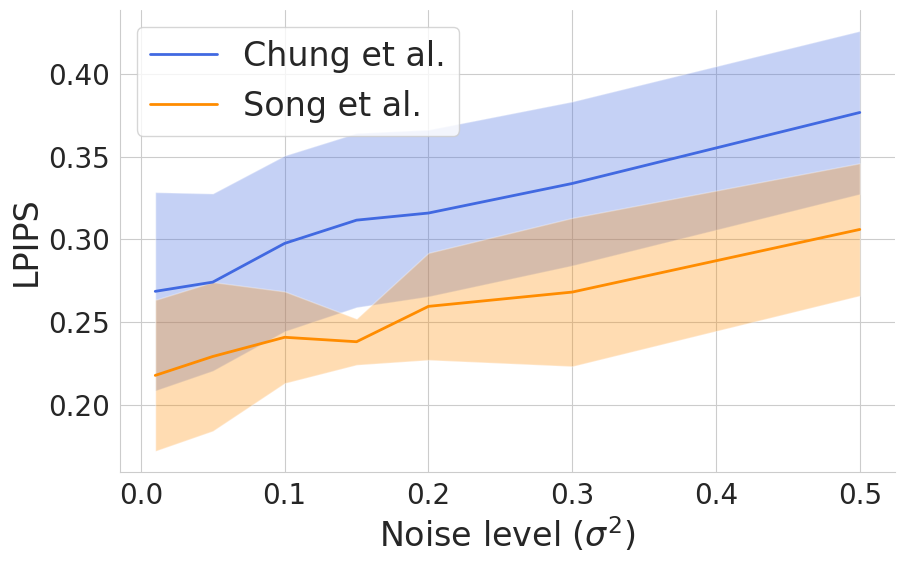

In [10]:
lpips_chung_list = []
lpips_pseudoinverse_list = []
indxs = [0,2,3,4,5]
sigma_noises = [0.01, 0.05, 0.1, 0.15, 0.2, 0.3, 0.5]

loss_fn_vgg = lpips.LPIPS(net='vgg').to(device)
loss_fn_vgg.eval()

for sigma_noise in sigma_noises:
    lpips_chung_sigma = []
    lpips_pseudoinverse_sigma = []
    for idx in indxs:
        x_chung = torch.load(f"inpainting_denoising/sigma{str(sigma_noise).replace('.','')}_idx{idx}_chung.pt")
        x_pseudoinverse = torch.load(f"inpainting_denoising/sigma{str(sigma_noise).replace('.','')}_idx{idx}_pseudoinverse.pt")
        x_true_pil = Image.open('ffhq256-1k-validation/'+str(idx).zfill(5)+'.png')
        x_true = pilimg_to_tensor(x_true_pil)
        #display_as_pilimg(torch.cat((x_true, x_chung, x_pseudoinverse), dim=3))
        lpips_chung = loss_fn_vgg(x_true, x_chung).item()
        lpips_pseudoinverse = loss_fn_vgg(x_true, x_pseudoinverse).item()
        lpips_chung_sigma.append(lpips_chung)
        lpips_pseudoinverse_sigma.append(lpips_pseudoinverse)
        
    lpips_chung_list.append(lpips_chung_sigma)
    lpips_pseudoinverse_list.append(lpips_pseudoinverse_sigma)

# Compute mean and std deviation
chung_mean = np.array([np.mean(p) for p in lpips_chung_list])
chung_std = np.array([np.std(p) for p in lpips_chung_list])
pseudoinverse_mean = np.array([np.mean(p) for p in lpips_pseudoinverse_list])
pseudoinverse_std = np.array([np.std(p) for p in lpips_pseudoinverse_list])

# Style setup
sns.set_style("whitegrid")
plt.figure(figsize=(10, 6))

# Plot with correctly sized confidence bands
plt.plot(sigma_noises, chung_mean, label="Chung et al.", color="royalblue", linewidth=2)
plt.fill_between(sigma_noises, chung_mean - chung_std, chung_mean + chung_std, 
                 color="royalblue", alpha=0.3, edgecolor=None)

plt.plot(sigma_noises, pseudoinverse_mean, label="Song et al.", color="darkorange", linewidth=2)
plt.fill_between(sigma_noises, pseudoinverse_mean - pseudoinverse_std, pseudoinverse_mean + pseudoinverse_std, 
                 color="darkorange", alpha=0.3, edgecolor=None)

# Labels and legend with correct sigma squared notation
plt.xlabel("Noise level ($\sigma^2$)", fontsize=24)
plt.ylabel("LPIPS", fontsize=24)
plt.legend(fontsize=24, loc="best")
# Change size of ticks
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)

# Improve aesthetics
sns.despine()
plt.savefig("inpainting_denoising/results.pdf", bbox_inches='tight')
plt.show()

### Gaussian deblurring

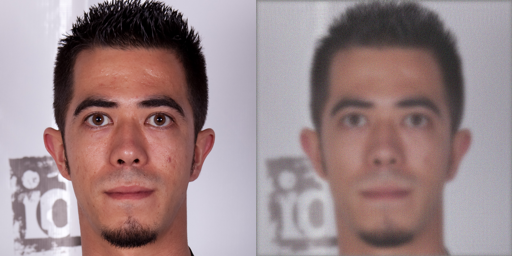

In [51]:
sigma = 10
channels = 3
image_size = 256
pdf = lambda x: torch.exp(torch.Tensor([-0.5 * (x/sigma)**2]))
kernel = torch.Tensor([pdf(-2), pdf(-1), pdf(0), pdf(1), pdf(2)]).to(device)
H_funcs = Deblurring(kernel / kernel.sum(), channels, image_size, device)
H_funcs2 = Deblurring(kernel / kernel.sum(), channels, image_size, device)

idx = 12
x_true_pil = Image.open('ffhq256-1k-validation/'+str(idx).zfill(5)+'.png')
x_true = pilimg_to_tensor(x_true_pil)

sigma_noise = 5/255
Hx = H_funcs.H(x_true.clone()).reshape(1, 3, 256, 256)
y = Hx + sigma_noise*torch.randn_like(x_true)
display_as_pilimg(torch.cat((x_true, y), dim=3));

In [ ]:
sigma_noises = [0.01, 0.05, 0.1, 0.15, 0.2, 0.3, 0.5]

def linear_operator(x):
    return H_funcs.H(x).reshape(1,3,256,256)

for idx in [2]:
    for sigma_noise in sigma_noises:
        x_true_pil = Image.open('ffhq256-1k-validation/'+str(idx).zfill(5)+'.png')
        x_true = pilimg_to_tensor(x_true_pil)
        y = linear_operator(x_true).reshape(1,3,256,256) + sigma_noise*torch.randn_like(x_true)
        y = y.clamp(-1.,1.)
        
        x_chung = ddpm.posterior_sampling(linear_operator, y, x_true=x_true, show_steps=False)
        x_pseudoinverse = ddpm.pseudoinverse_guidance_deblurring(H_funcs, H_funcs2, sigma_noise, y, 0.04, x_true, show_steps=False, vis_y=None)
        print(f"--------------------sigma_noise: {sigma_noise}, idx: {idx}--------------------")
        display_as_pilimg(torch.cat((x_true, y, x_chung, x_pseudoinverse), dim=3))
        
        sigma_name = str(sigma_noise).replace('.','')
        torch.save(x_chung, f"gaussian_deblurring/sigma{sigma_name}_idx{idx}_chung.pt")
        torch.save(x_pseudoinverse, f"gaussian_deblurring/sigma{sigma_name}_idx{idx}_pseudoinverse.pt")
        
        print(f"PNSR Noisy: {mypsnr(x_true, y):.4f}")
        print(f"PSNR Chung: {mypsnr(x_true, x_chung):.4f}")
        print(f"PSNR Pseudoinverse: {mypsnr(x_true, x_pseudoinverse):.4f}")

### Uniform deblurring

In [ ]:
sigma = 10
channels = 3
image_size = 256

H_funcsUni = Deblurring(torch.Tensor([1/9] * 9).to(device), 3, 256, device)
H_funcs2Uni = Deblurring(torch.Tensor([1/9] * 9).to(device), 3, 256, device)

idx = 12
x_true_pil = Image.open('ffhq256-1k-validation/'+str(idx).zfill(5)+'.png')
x_true = pilimg_to_tensor(x_true_pil)

sigma_noise = 5/255
Hx = H_funcsUni.H(x_true.clone()).reshape(1, 3, 256, 256)
y = Hx + sigma_noise*torch.randn_like(x_true)
display_as_pilimg(torch.cat((x_true, y), dim=3));

In [ ]:
sigma_noises = [0.01, 0.05, 0.1, 0.15, 0.2, 0.3, 0.5]

def linear_operator(x):
    return H_funcsUni.H(x).reshape(1,3,256,256)

for idx in [12]:
    for sigma_noise in sigma_noises:
        x_true_pil = Image.open('ffhq256-1k-validation/'+str(idx).zfill(5)+'.png')
        x_true = pilimg_to_tensor(x_true_pil)
        y = linear_operator(x_true).reshape(1,3,256,256) + sigma_noise*torch.randn_like(x_true)
        y = y.clamp(-1.,1.)
        
        x_chung = ddpm.posterior_sampling(linear_operator, y, x_true=x_true, show_steps=False)
        x_pseudoinverse = ddpm.pseudoinverse_guidance_deblurring(H_funcsUni, H_funcs2Uni, sigma_noise, y, 0.04, x_true, show_steps=False, vis_y=None)
        print(f"--------------------sigma_noise: {sigma_noise}, idx: {idx}--------------------")
        display_as_pilimg(torch.cat((x_true, y, x_chung, x_pseudoinverse), dim=3))
        
        sigma_name = str(sigma_noise).replace('.','')
        torch.save(x_chung, f"uniform_deblurring/sigma{sigma_name}_idx{idx}_chung.pt")
        torch.save(x_pseudoinverse, f"uniform_deblurring/sigma{sigma_name}_idx{idx}_pseudoinverse.pt")
        
        print(f"PNSR Noisy: {mypsnr(x_true, y):.4f}")
        print(f"PSNR Chung: {mypsnr(x_true, x_chung):.4f}")
        print(f"PSNR Pseudoinverse: {mypsnr(x_true, x_pseudoinverse):.4f}")

### Images for the report

In [ ]:
lpips_chung_list = []
lpips_pseudoinverse_list = []
indxs = [0,2,3,4,5]
sigma_noises = [0.01, 0.05, 0.1, 0.15, 0.2, 0.3, 0.5]

def linear_operator(x):
  return x

for idx in indxs:
    chung_images = []
    pseudoinverse_images = []
    noisy_images = []
    for sigma_noise in sigma_noises:
        x_true_pil = Image.open('ffhq256-1k-validation/'+str(idx).zfill(5)+'.png')
        x_true = pilimg_to_tensor(x_true_pil)
        y = linear_operator(x_true.clone()) + linear_operator(sigma_noise * torch.randn_like(x_true))
        y = y.clamp(-1.,1.)
        
        x_chung = torch.load(f"denoising/sigma{str(sigma_noise).replace('.','')}_idx{idx}_chung.pt")
        x_pseudoinverse = torch.load(f"denoising/sigma{str(sigma_noise).replace('.','')}_idx{idx}_pseudoinverse.pt")
        x_true_pil = Image.open('ffhq256-1k-validation/'+str(idx).zfill(5)+'.png')
        x_true = pilimg_to_tensor(x_true_pil)
        chung_images.append(x_chung)
        pseudoinverse_images.append(x_pseudoinverse)
        noisy_images.append(y)
        
    display_images_with_captions(noisy_images, sigma_noises, f"denoising/idx{idx}_noisy.pdf", white=True)
    display_images_with_captions(chung_images, [None for i in sigma_noises], f"denoising/idx{idx}_chung.pdf", white=False)
    display_images_with_captions(pseudoinverse_images, [None for i in sigma_noises], f"denoising/idx{idx}_pseudoinverse.pdf", white=False)

/tmp/ipykernel_14834/1249133860.py:26: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  x_chung = torch.load(f"inpainting_denoising/sigma{str(sigma_noise).replace('.','')}_idx{

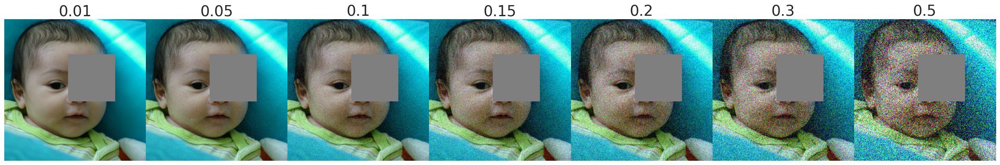

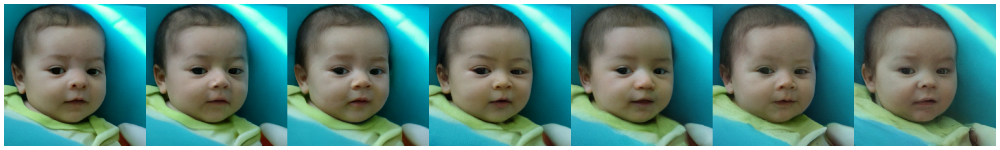

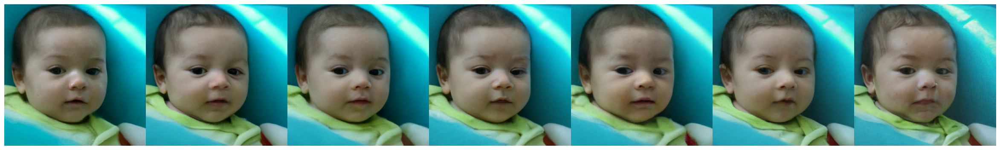

/tmp/ipykernel_14834/1249133860.py:26: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  x_chung = torch.load(f"inpainting_denoising/sigma{str(sigma_noise).replace('.','')}_idx{

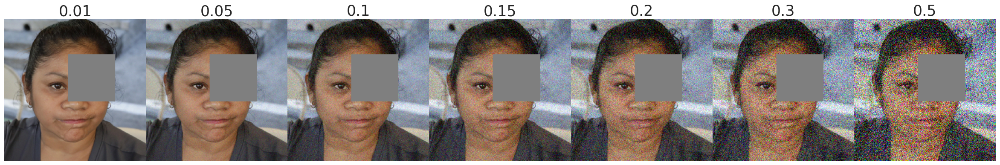

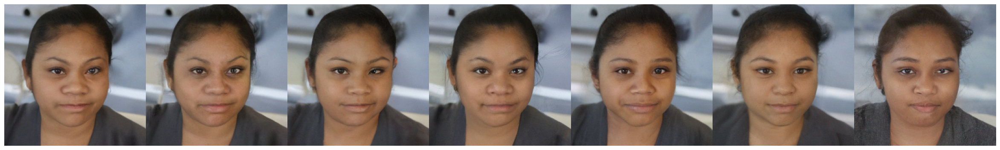

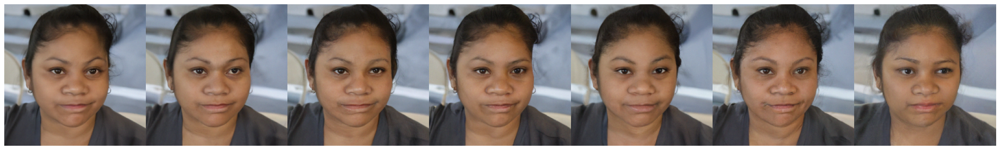

/tmp/ipykernel_14834/1249133860.py:26: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  x_chung = torch.load(f"inpainting_denoising/sigma{str(sigma_noise).replace('.','')}_idx{

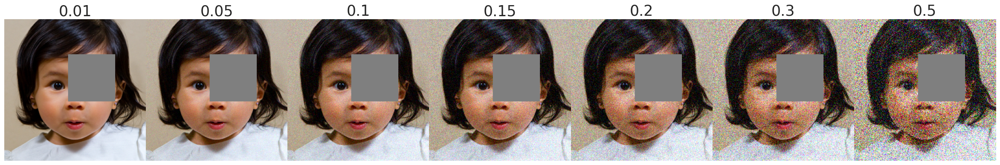

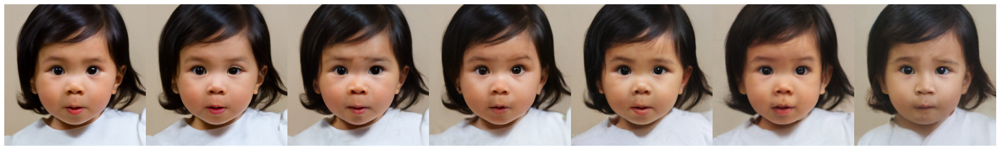

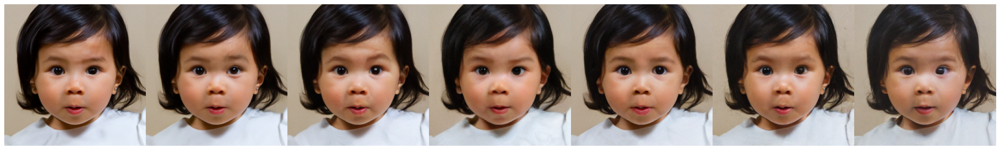

/tmp/ipykernel_14834/1249133860.py:26: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  x_chung = torch.load(f"inpainting_denoising/sigma{str(sigma_noise).replace('.','')}_idx{

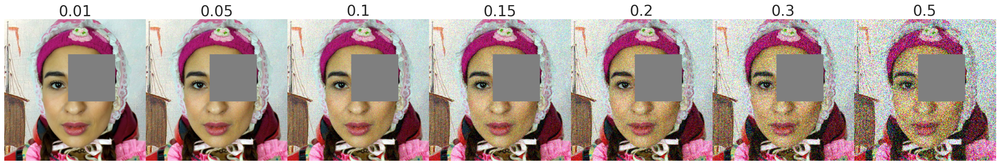

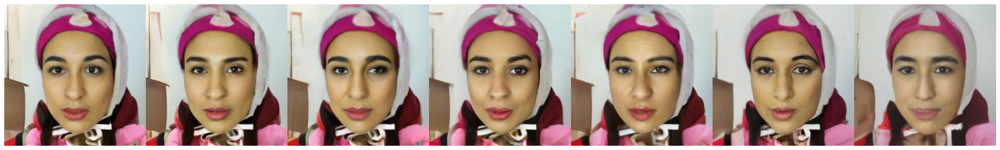

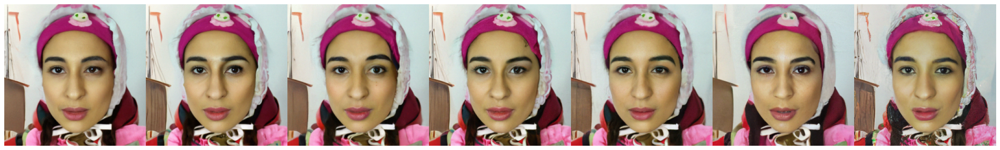

/tmp/ipykernel_14834/1249133860.py:26: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  x_chung = torch.load(f"inpainting_denoising/sigma{str(sigma_noise).replace('.','')}_idx{

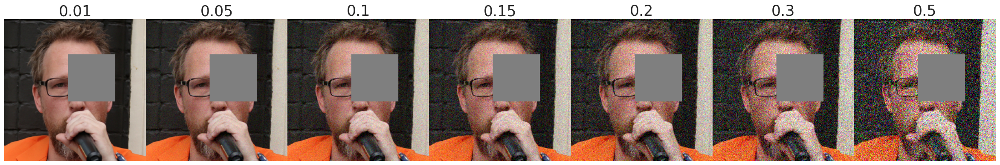

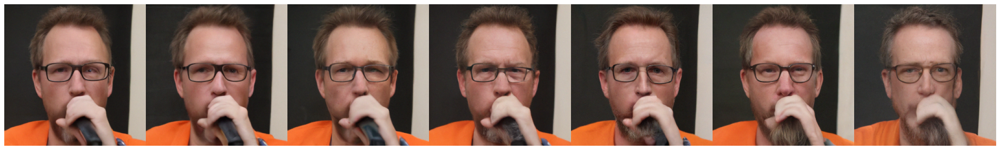

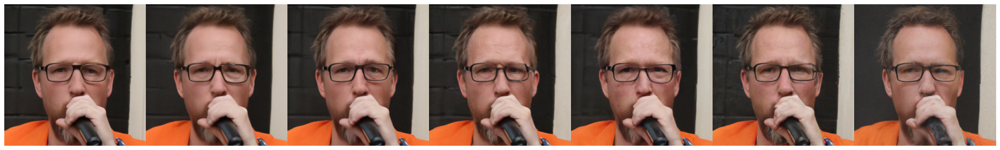

In [ ]:
lpips_chung_list = []
lpips_pseudoinverse_list = []
indxs = [0,2,3,4,5]
sigma_noises = [0.01, 0.05, 0.1, 0.15, 0.2, 0.3, 0.5]

h = 256
w = 256
hcrop, wcrop = h//3, w//3
corner_top, corner_left = h//4, int(0.45*w)
mask = torch.ones(ddpm.imgshape, device=device)
mask[:,:,corner_top:corner_top+hcrop,corner_left:corner_left+wcrop] = 0

def linear_operator(x):
  return x*mask

for idx in indxs:
    chung_images = []
    pseudoinverse_images = []
    noisy_images = []
    for sigma_noise in sigma_noises:
        x_true_pil = Image.open('ffhq256-1k-validation/'+str(idx).zfill(5)+'.png')
        x_true = pilimg_to_tensor(x_true_pil)
        y = linear_operator(x_true.clone()) + linear_operator(sigma_noise * torch.randn_like(x_true))
        y = y.clamp(-1.,1.)
        
        x_chung = torch.load(f"inpainting_denoising/sigma{str(sigma_noise).replace('.','')}_idx{idx}_chung.pt")
        x_pseudoinverse = torch.load(f"inpainting_denoising/sigma{str(sigma_noise).replace('.','')}_idx{idx}_pseudoinverse.pt")
        x_true_pil = Image.open('ffhq256-1k-validation/'+str(idx).zfill(5)+'.png')
        x_true = pilimg_to_tensor(x_true_pil)
        chung_images.append(x_chung)
        pseudoinverse_images.append(x_pseudoinverse)
        noisy_images.append(y)
        
    display_images_with_captions(noisy_images, sigma_noises, f"inpainting_denoising/idx{idx}_noisy.pdf", white=False)
    display_images_with_captions(chung_images, [None for i in sigma_noises], f"inpainting_denoising/idx{idx}_chung.pdf", white=False)
    display_images_with_captions(pseudoinverse_images, [None for i in sigma_noises], f"inpainting_denoising/idx{idx}_pseudoinverse.pdf", white=False)

/tmp/ipykernel_14834/334046955.py:26: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  x_chung = torch.load(f"gaussian_deblurring/sigma{str(sigma_noise).replace('.','')}_idx{id

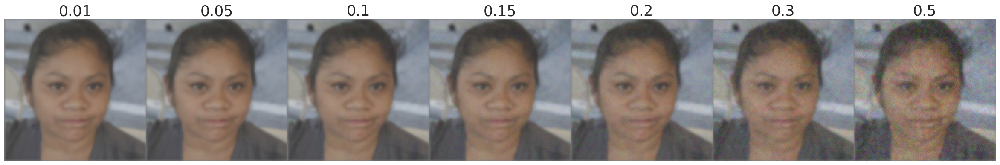

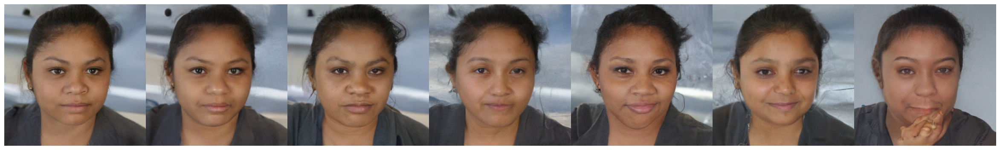

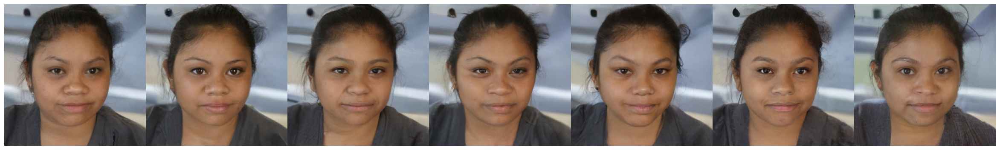

In [91]:
sigma = 10
channels = 3
image_size = 256
pdf = lambda x: torch.exp(torch.Tensor([-0.5 * (x/sigma)**2]))
kernel = torch.Tensor([pdf(-2), pdf(-1), pdf(0), pdf(1), pdf(2)]).to(device)
H_funcs = Deblurring(kernel / kernel.sum(), channels, image_size, device)
H_funcs2 = Deblurring(kernel / kernel.sum(), channels, image_size, device)

lpips_chung_list = []
lpips_pseudoinverse_list = []
sigma_noises = [0.01, 0.05, 0.1, 0.15, 0.2, 0.3, 0.5]

def linear_operator(x):
    return H_funcs.H(x).reshape(1,3,256,256)

for idx in [2]:
    chung_images = []
    pseudoinverse_images = []
    noisy_images = []
    for sigma_noise in sigma_noises:
        x_true_pil = Image.open('ffhq256-1k-validation/'+str(idx).zfill(5)+'.png')
        x_true = pilimg_to_tensor(x_true_pil)
        y = linear_operator(x_true.clone()) + linear_operator(sigma_noise * torch.randn_like(x_true))
        y = y.clamp(-1.,1.)
        
        x_chung = torch.load(f"gaussian_deblurring/sigma{str(sigma_noise).replace('.','')}_idx{idx}_chung.pt")
        x_pseudoinverse = torch.load(f"gaussian_deblurring/sigma{str(sigma_noise).replace('.','')}_idx{idx}_pseudoinverse.pt")
        x_true_pil = Image.open('ffhq256-1k-validation/'+str(idx).zfill(5)+'.png')
        x_true = pilimg_to_tensor(x_true_pil)
        chung_images.append(x_chung)
        pseudoinverse_images.append(x_pseudoinverse)
        noisy_images.append(y)
        
    display_images_with_captions(noisy_images, sigma_noises, f"gaussian_deblurring/idx{idx}_noisy.pdf", white=False)
    display_images_with_captions(chung_images, [None for i in sigma_noises], f"gaussian_deblurring/idx{idx}_chung.pdf", white=False)
    display_images_with_captions(pseudoinverse_images, [None for i in sigma_noises], f"gaussian_deblurring/idx{idx}_pseudoinverse.pdf", white=False)

In [ ]:
sigma = 10
channels = 3
image_size = 256
H_funcsUni = Deblurring(torch.Tensor([1/9] * 9).to(device), 3, 256, device)
H_funcs2Uni = Deblurring(torch.Tensor([1/9] * 9).to(device), 3, 256, device)

lpips_chung_list = []
lpips_pseudoinverse_list = []
sigma_noises = [0.01, 0.05, 0.1, 0.15, 0.2, 0.3, 0.5]

def linear_operator(x):
    return H_funcsUni.H(x).reshape(1,3,256,256)

for idx in [12]:
    chung_images = []
    pseudoinverse_images = []
    noisy_images = []
    for sigma_noise in sigma_noises:
        x_true_pil = Image.open('ffhq256-1k-validation/'+str(idx).zfill(5)+'.png')
        x_true = pilimg_to_tensor(x_true_pil)
        y = linear_operator(x_true.clone()) + linear_operator(sigma_noise * torch.randn_like(x_true))
        y = y.clamp(-1.,1.)
        
        x_chung = torch.load(f"gaussian_deblurring/sigma{str(sigma_noise).replace('.','')}_idx{idx}_chung.pt")
        x_pseudoinverse = torch.load(f"gaussian_deblurring/sigma{str(sigma_noise).replace('.','')}_idx{idx}_pseudoinverse.pt")
        x_true_pil = Image.open('ffhq256-1k-validation/'+str(idx).zfill(5)+'.png')
        x_true = pilimg_to_tensor(x_true_pil)
        chung_images.append(x_chung)
        pseudoinverse_images.append(x_pseudoinverse)
        noisy_images.append(y)
        
    display_images_with_captions(noisy_images, sigma_noises, f"uniform_deblurring/idx{idx}_noisy.pdf", white=False)
    display_images_with_captions(chung_images, [None for i in sigma_noises], f"uniform_deblurring/idx{idx}_chung.pdf", white=False)
    display_images_with_captions(pseudoinverse_images, [None for i in sigma_noises], f"uniform_deblurring/idx{idx}_pseudoinverse.pdf", white=False)